In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline


data = pd.read_csv('network_backup_dataset.csv', sep=',')

print(len(data))
data.head()

18588


,Week #,Day of Week,Backup Start Time - Hour of Day,Work-Flow-ID,File Name,Size of Backup (GB),Backup Time (hour)
0,1,Monday,1,work_flow_0,File_0,0.0,0
1,1,Monday,1,work_flow_2,File_12,0.0,0
2,1,Monday,1,work_flow_2,File_13,0.0,0
3,1,Monday,1,work_flow_2,File_14,0.0,0
4,1,Monday,1,work_flow_2,File_16,0.0,0


# Part c Neural Networks Regression

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn import datasets, linear_model, metrics
from sklearn.model_selection import cross_val_score,cross_val_predict,cross_validate
from sklearn.preprocessing import StandardScaler
from sklearn import feature_selection
from sklearn.neural_network import MLPRegressor

df = pd.read_csv('network_backup_dataset.csv', sep=',')

data = df.replace({'Day of Week': {'Monday': 0, 'Tuesday': 1, 'Wednesday': 2, 'Thursday': 3, 'Friday': 4,
                                   'Saturday': 5, 'Sunday': 6},
                  'Work-Flow-ID': {'work_flow_0': 0, 'work_flow_1': 1, 'work_flow_2': 2, 'work_flow_3': 3,
                                   'work_flow_4': 4},
                  'File Name': {'File_0': 0, 'File_1': 1, 'File_2': 2, 'File_3': 3, 'File_4': 4, 'File_5': 5,
                                'File_6': 6, 'File_7': 7, 'File_8': 8, 'File_9': 9, 'File_10': 10, 'File_11': 11,
                                'File_12': 12, 'File_13': 13, 'File_14': 14, 'File_15': 15, 'File_16': 16,
                                'File_17': 17, 'File_18': 18, 'File_19': 19, 'File_20': 20, 'File_21': 21,
                                'File_22': 22, 'File_23': 23, 'File_24': 24, 'File_25': 25, 'File_26': 26, 
                                'File_27': 27,'File_28': 28, 'File_29': 29, }})
data.head()

X=data[['Week #', 'Day of Week', 'Backup Start Time - Hour of Day', 
        'Work-Flow-ID','File Name']]

y=data['Size of Backup (GB)']


In [3]:
from sklearn.preprocessing import OneHotEncoder

enc = OneHotEncoder()
X_enc = enc.fit_transform(X)

print(X_enc.shape)


(18588, 63)


In [4]:
def print_RMSEs_plot(features,targets,model,test_RMSE,train_RMSE):
    #linear_regression = linear_model.LinearRegression()
    predicted = cross_val_predict(model, features, targets, cv=10)
    #print ("Test RMSE with cross validation:", np.sqrt(metrics.mean_squared_error(targets, predicted)))
    cv_scores = cross_validate(model, features, targets, cv=10, scoring='neg_mean_squared_error',return_train_score=True)

    Test_RMSE=(sum(cv_scores['test_score'])/-10.0)**0.5
    Train_RMSE=(sum(cv_scores['train_score'])/-10.0)**0.5

    test_RMSE.append(Test_RMSE)
    train_RMSE.append(Train_RMSE)
    
    print ("Test RMSE with cross validation: %0.7f"%Test_RMSE )
    print ("Train RMSE with cross validation: %0.7f"%Train_RMSE )

    print('')
    print("Fitted values vs. true values ")
    plt.figure(figsize=(12,4))
    plt.scatter(range(0,len(targets)), targets, s=1,label='true vlaues')
    plt.scatter(range(0,len(targets)), predicted,s=1, label='fitted values') 
    plt.ylim(0,0.4)
    plt.legend(loc='best')
    plt.xlabel('Time')
    plt.ylabel('fitted values and true values')
    plt.show()

    #Residual
    print(" residuals vs. ﬁtted values ")
    y_residual =targets-predicted
    plt.figure(figsize=(12,4))
    plt.scatter(range(0,len(targets)), predicted,s=1, label='fitted values')
    plt.scatter(range(0,len(targets)), y_residual,s=1, label='residuals')
    plt.ylim(0,0.4)
    plt.legend(loc='best')
    plt.xlabel('Time')
    plt.ylabel('Residual values and fitted values')
    plt.show()

hidden_units:5
Test RMSE with cross validation: 0.0866618
Train RMSE with cross validation: 0.0857770

Fitted values vs. true values 


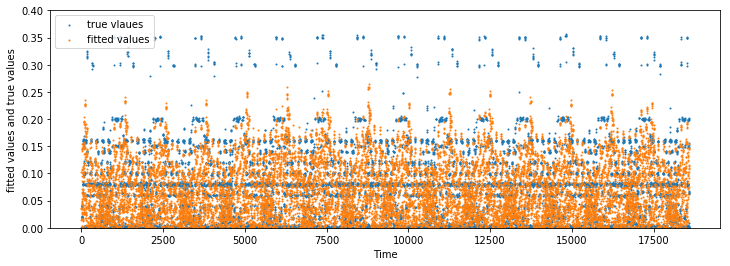

 residuals vs. ﬁtted values 


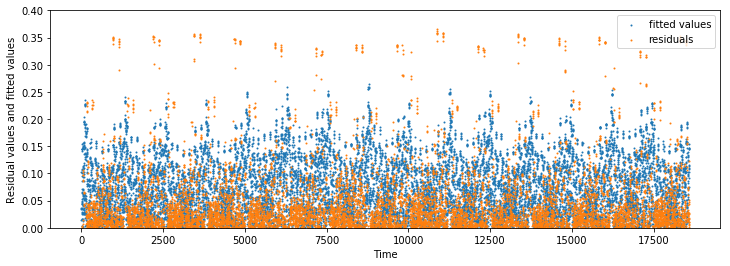

hidden_units:10
Test RMSE with cross validation: 0.0629455
Train RMSE with cross validation: 0.0579396

Fitted values vs. true values 


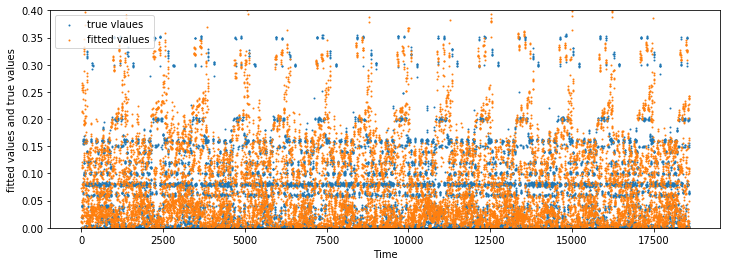

 residuals vs. ﬁtted values 


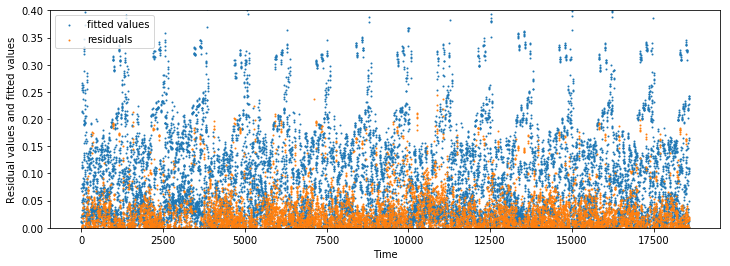

hidden_units:15
Test RMSE with cross validation: 0.0433685
Train RMSE with cross validation: 0.0294423

Fitted values vs. true values 


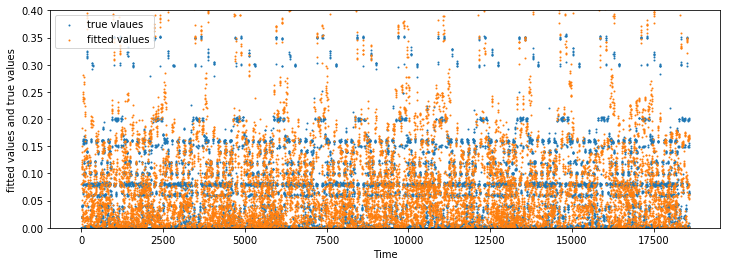

 residuals vs. ﬁtted values 


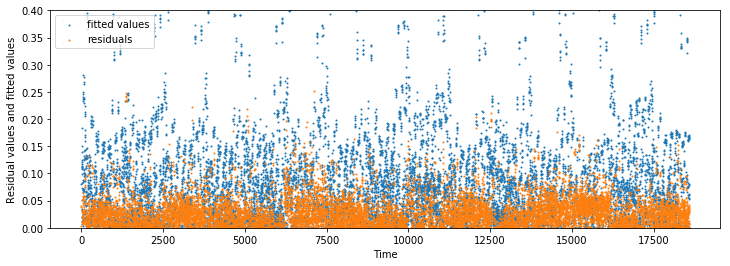

hidden_units:20
Test RMSE with cross validation: 0.0495424
Train RMSE with cross validation: 0.0289853

Fitted values vs. true values 


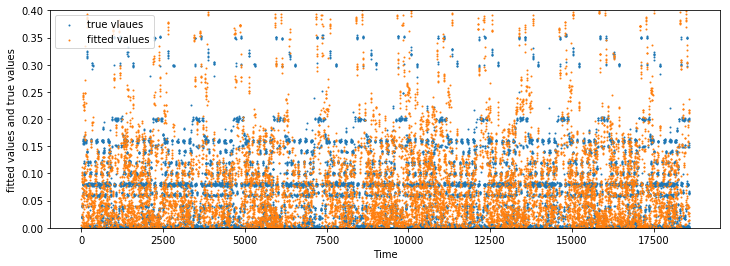

 residuals vs. ﬁtted values 


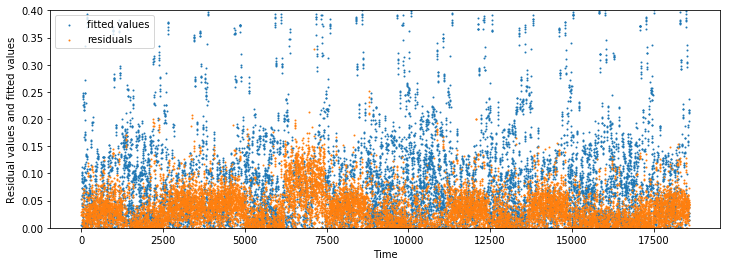

hidden_units:25
Test RMSE with cross validation: 0.1028732
Train RMSE with cross validation: 0.0332647

Fitted values vs. true values 


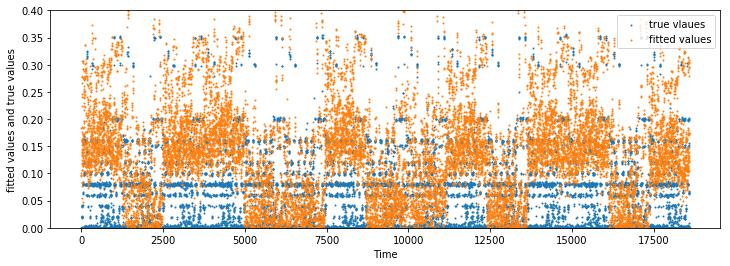

 residuals vs. ﬁtted values 


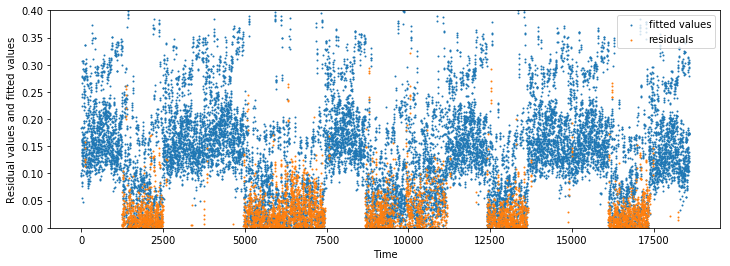

hidden_units:30
Test RMSE with cross validation: 0.0594232
Train RMSE with cross validation: 0.0275443

Fitted values vs. true values 


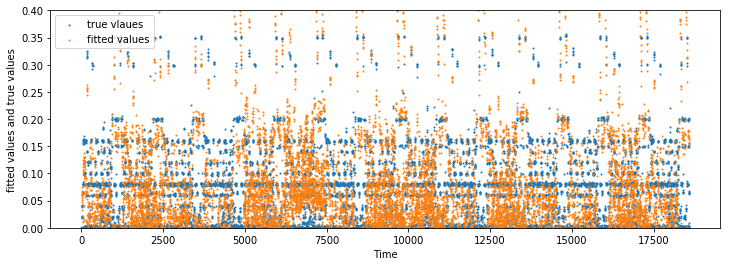

 residuals vs. ﬁtted values 


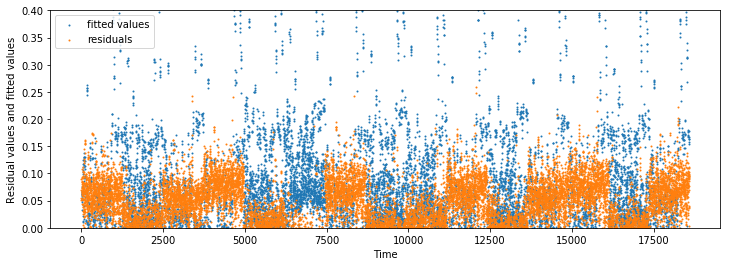

hidden_units:35
Test RMSE with cross validation: 0.0470812
Train RMSE with cross validation: 0.0256184

Fitted values vs. true values 


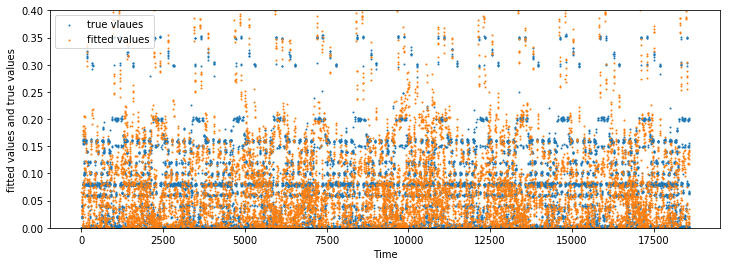

 residuals vs. ﬁtted values 


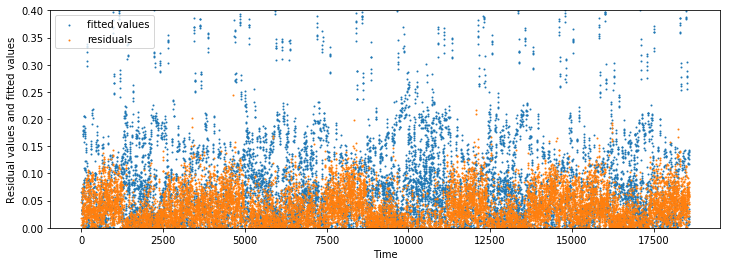

hidden_units:40
Test RMSE with cross validation: 0.0505989
Train RMSE with cross validation: 0.0364315

Fitted values vs. true values 


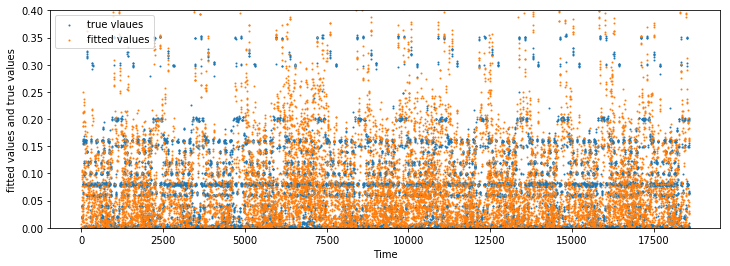

 residuals vs. ﬁtted values 


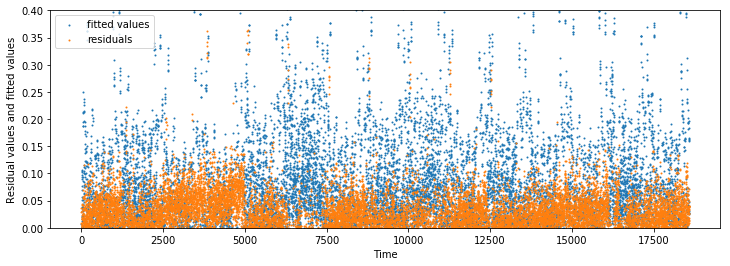

hidden_units:45
Test RMSE with cross validation: 0.0335226
Train RMSE with cross validation: 0.0243424

Fitted values vs. true values 


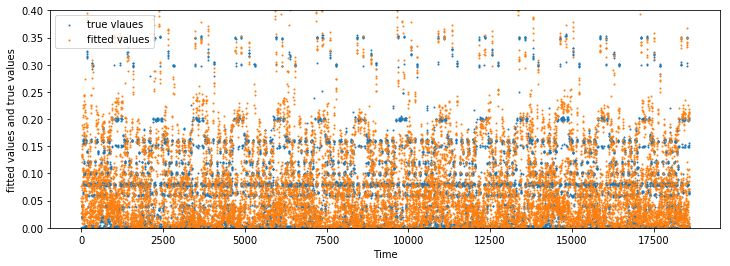

 residuals vs. ﬁtted values 


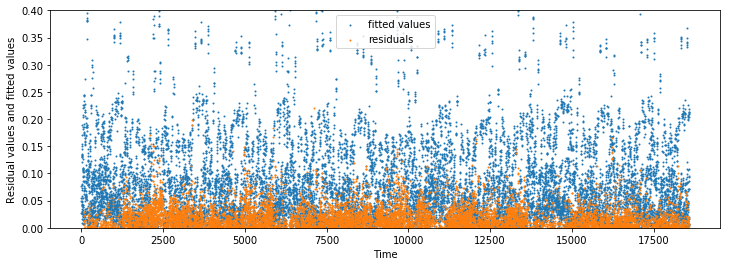

hidden_units:50
Test RMSE with cross validation: 0.0396459
Train RMSE with cross validation: 0.0227056

Fitted values vs. true values 


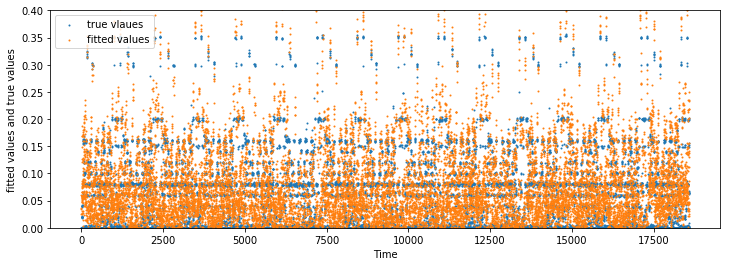

 residuals vs. ﬁtted values 


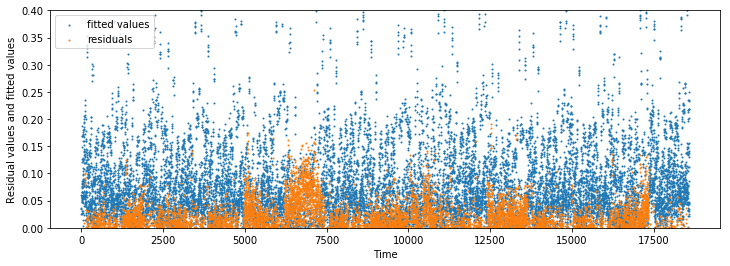

hidden_units:55
Test RMSE with cross validation: 0.0343067
Train RMSE with cross validation: 0.0238233

Fitted values vs. true values 


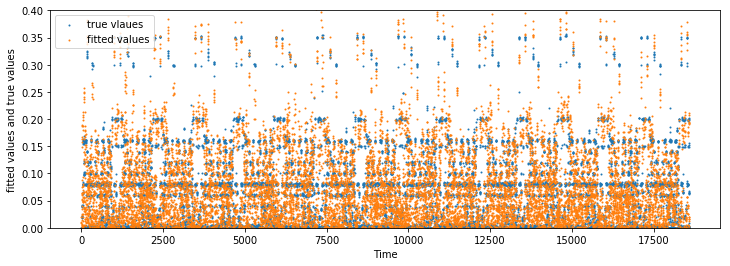

 residuals vs. ﬁtted values 


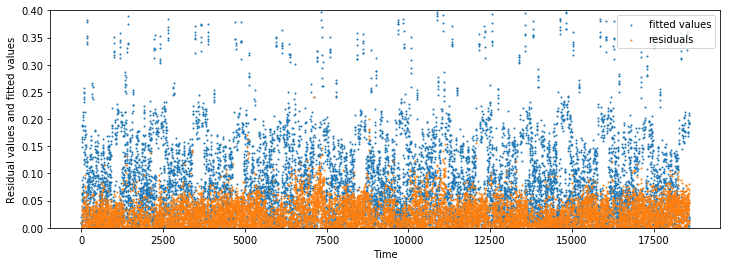

hidden_units:60
Test RMSE with cross validation: 0.0796871
Train RMSE with cross validation: 0.0382576

Fitted values vs. true values 


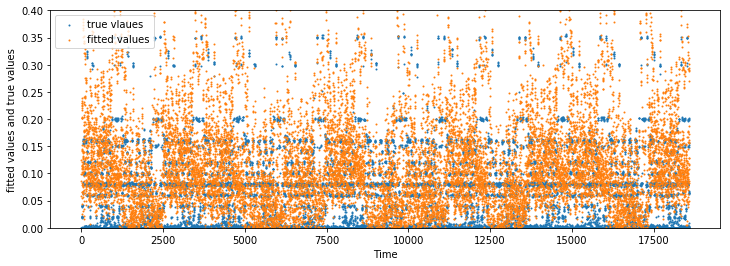

 residuals vs. ﬁtted values 


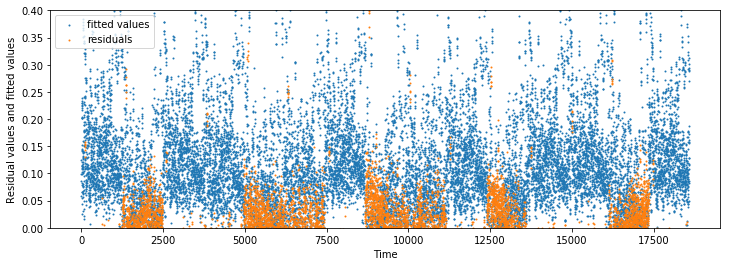

hidden_units:65
Test RMSE with cross validation: 0.0421932
Train RMSE with cross validation: 0.0281629

Fitted values vs. true values 


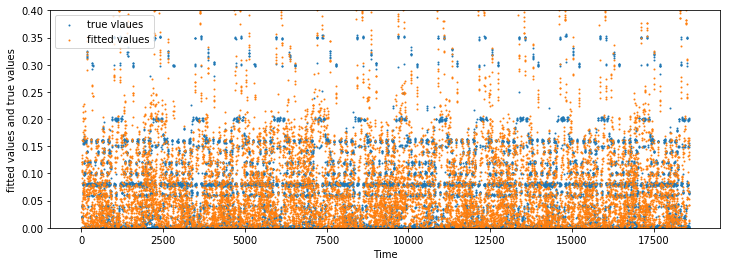

 residuals vs. ﬁtted values 


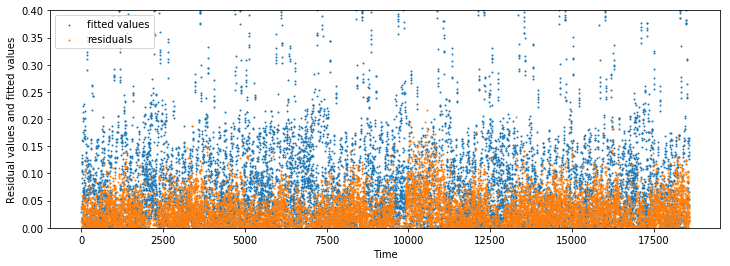

hidden_units:70
Test RMSE with cross validation: 0.0386579
Train RMSE with cross validation: 0.0218931

Fitted values vs. true values 


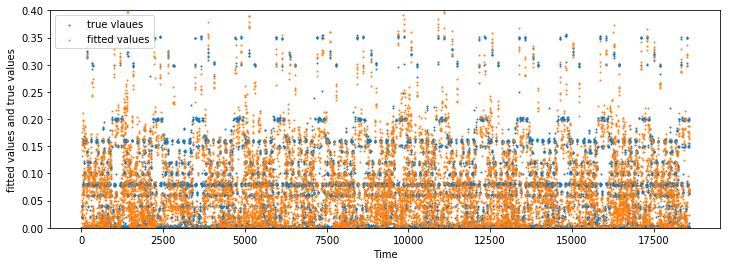

 residuals vs. ﬁtted values 


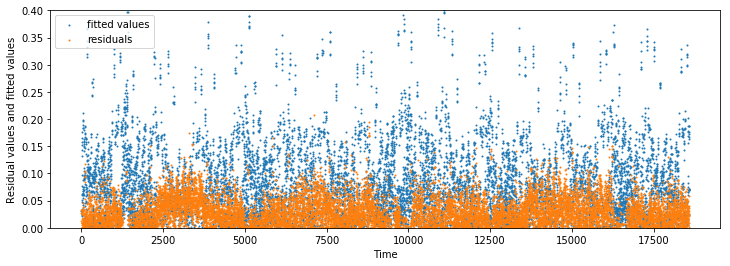

hidden_units:75
Test RMSE with cross validation: 0.0549438
Train RMSE with cross validation: 0.0270968

Fitted values vs. true values 


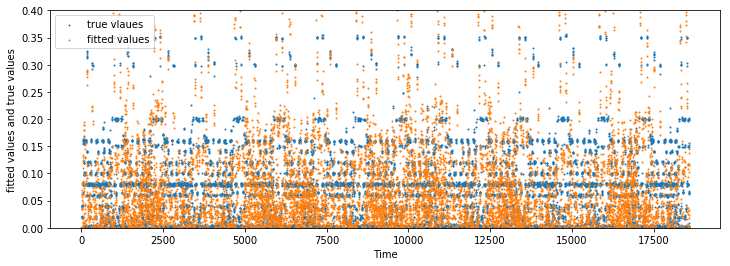

 residuals vs. ﬁtted values 


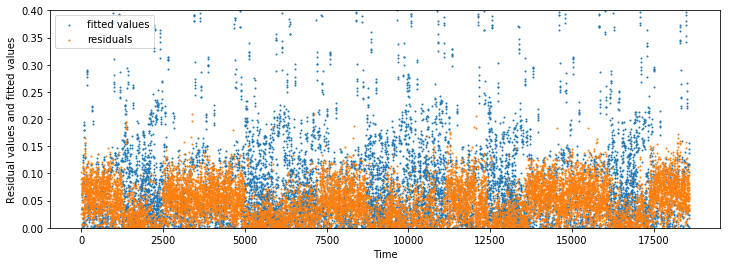

hidden_units:80
Test RMSE with cross validation: 0.0419521
Train RMSE with cross validation: 0.0233309

Fitted values vs. true values 


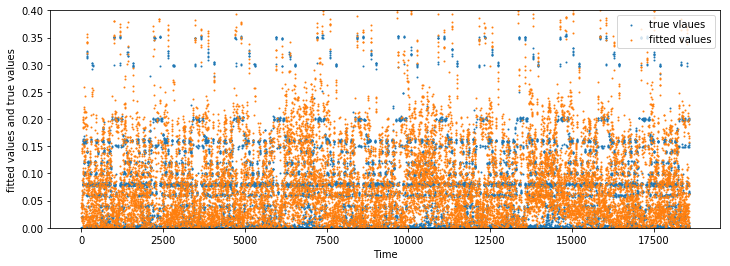

 residuals vs. ﬁtted values 


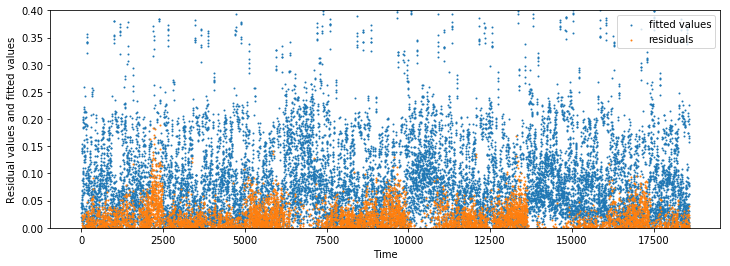

hidden_units:85
Test RMSE with cross validation: 0.0367662
Train RMSE with cross validation: 0.0203984

Fitted values vs. true values 


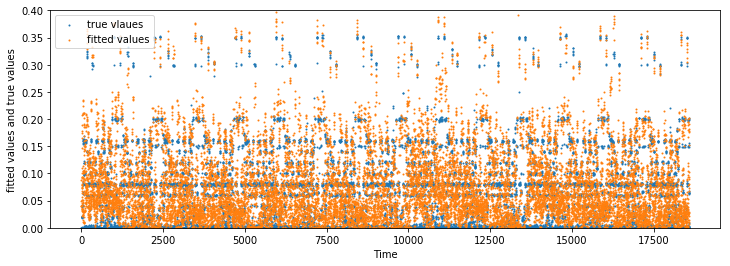

 residuals vs. ﬁtted values 


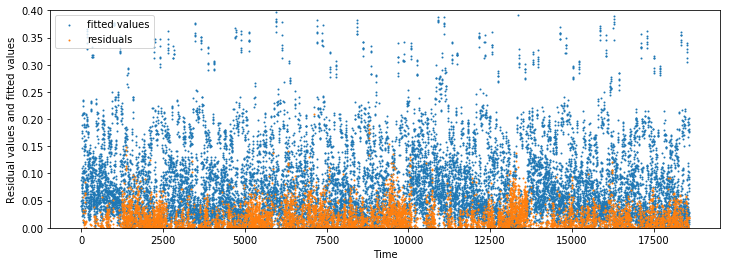

hidden_units:90
Test RMSE with cross validation: 0.0568317
Train RMSE with cross validation: 0.0228273

Fitted values vs. true values 


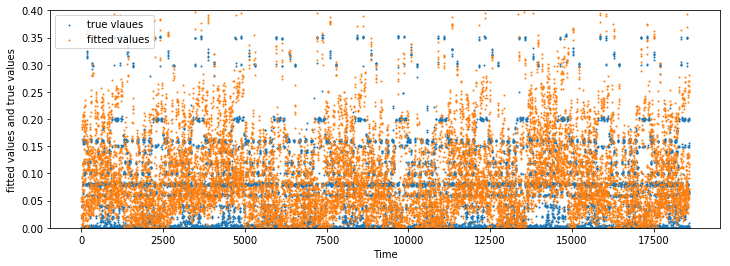

 residuals vs. ﬁtted values 


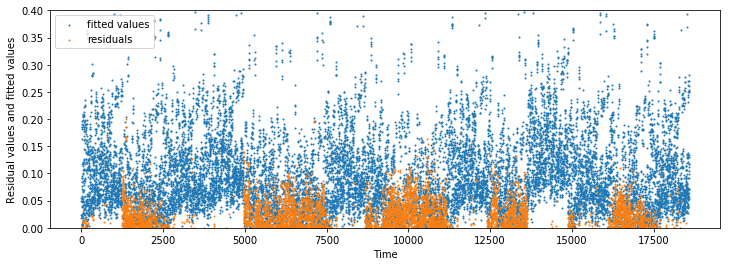

hidden_units:95
Test RMSE with cross validation: 0.0547244
Train RMSE with cross validation: 0.0224440

Fitted values vs. true values 


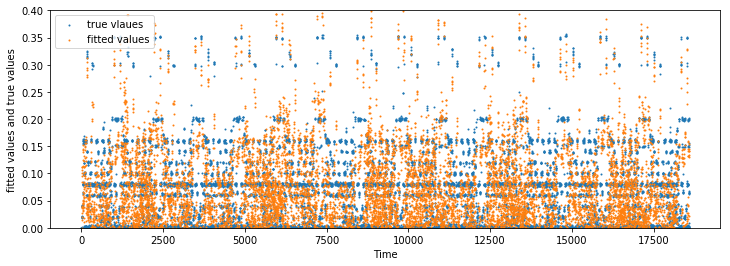

 residuals vs. ﬁtted values 


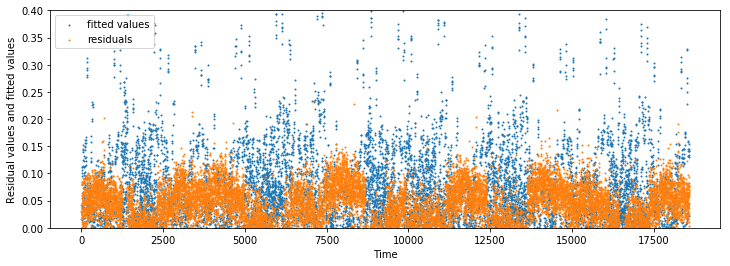

hidden_units:100
Test RMSE with cross validation: 0.0443001
Train RMSE with cross validation: 0.0241715

Fitted values vs. true values 


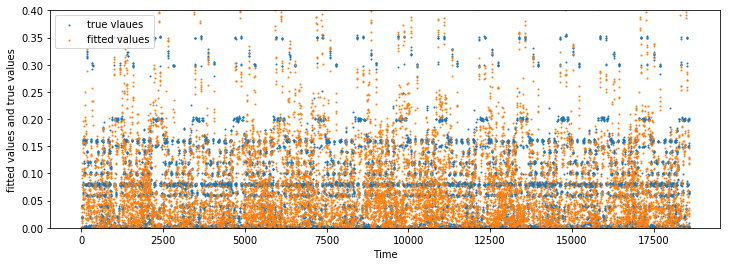

 residuals vs. ﬁtted values 


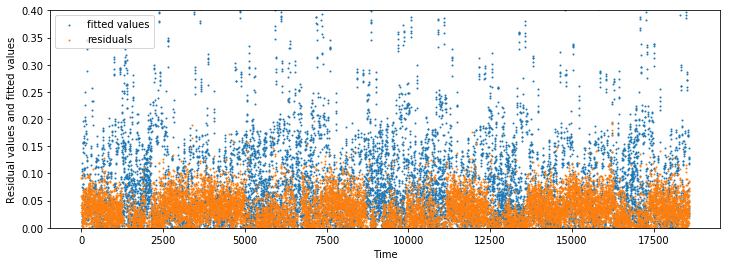

In [5]:
test_RMSE = []
train_RMSE = []

for hidden_units in range(5,105,5):
    print('hidden_units:%d'%hidden_units)
    clf_relu = MLPRegressor(activation='relu', alpha=1e-5,hidden_layer_sizes=(hidden_units,), random_state=1)
    print_RMSEs_plot(X_enc,y,clf_relu,test_RMSE,train_RMSE)

#clf_logistic = MLPRegressor((activation='logistic', alpha=1e-5,hidden_layer_sizes=(15,), random_state=1)
#clf_logistic = MLPRegressor((activation='tanh', alpha=1e-5,hidden_layer_sizes=(15,), random_state=1)


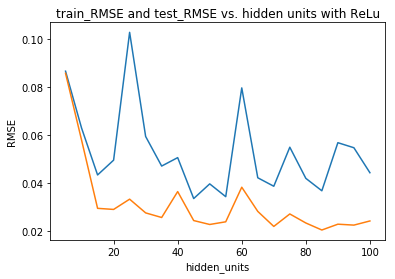

In [6]:
plt.plot(range(5,105,5),test_RMSE,range(5,105,5),train_RMSE)
plt.xlabel('hidden_units')
plt.ylabel('RMSE')
plt.title('train_RMSE and test_RMSE vs. hidden units with ReLu')
plt.show()

hidden_units:5
Test RMSE with cross validation: 0.0903741
Train RMSE with cross validation: 0.0886132

Fitted values vs. true values 


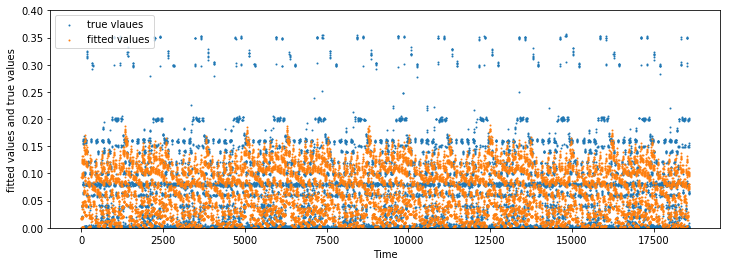

 residuals vs. ﬁtted values 


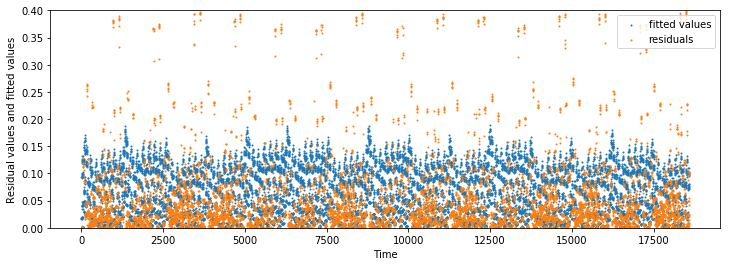

hidden_units:10
Test RMSE with cross validation: 0.0931788
Train RMSE with cross validation: 0.0885051

Fitted values vs. true values 


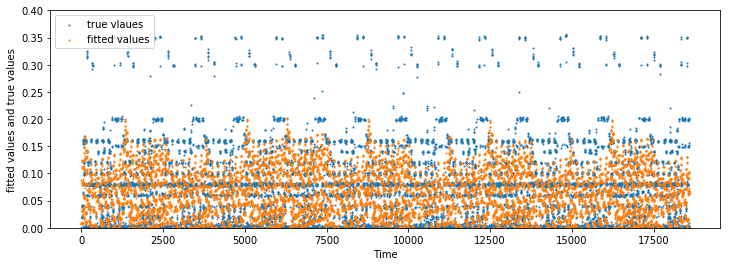

 residuals vs. ﬁtted values 


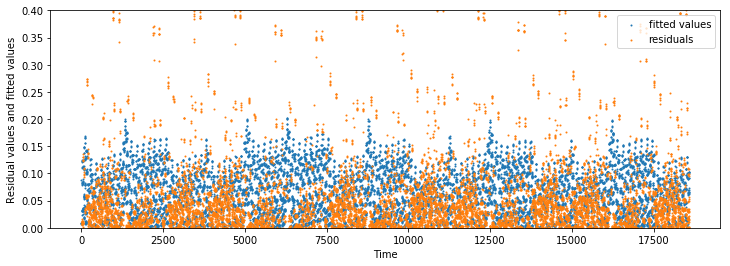

hidden_units:15
Test RMSE with cross validation: 0.0904965
Train RMSE with cross validation: 0.0883978

Fitted values vs. true values 


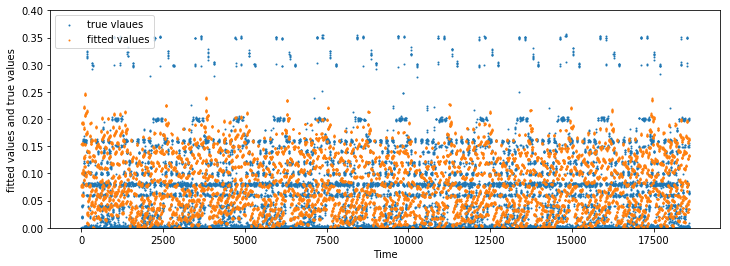

 residuals vs. ﬁtted values 


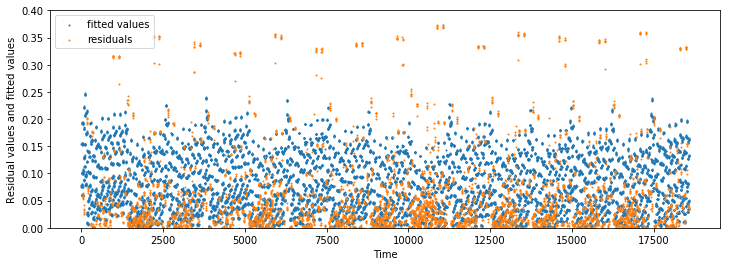

hidden_units:20
Test RMSE with cross validation: 0.0910104
Train RMSE with cross validation: 0.0884090

Fitted values vs. true values 


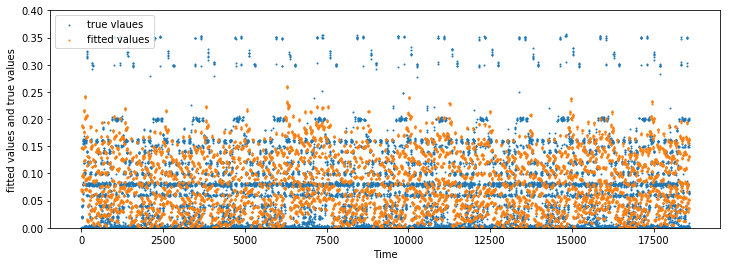

 residuals vs. ﬁtted values 


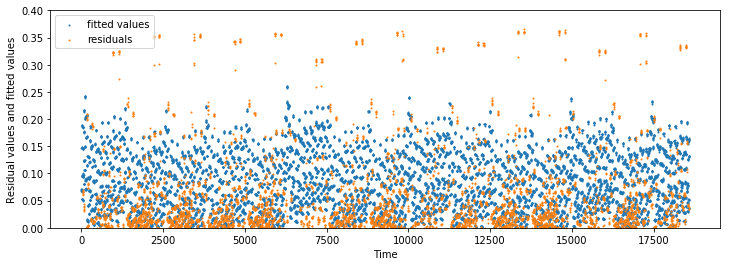

hidden_units:25
Test RMSE with cross validation: 0.0907964
Train RMSE with cross validation: 0.0884249

Fitted values vs. true values 


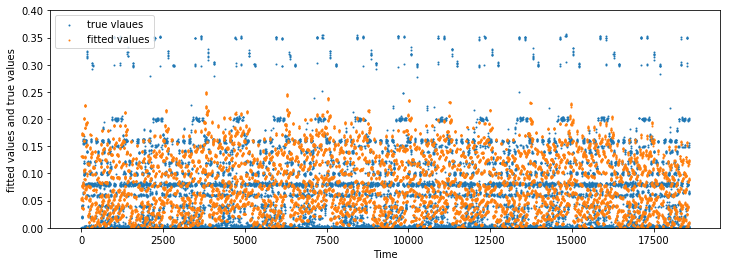

 residuals vs. ﬁtted values 


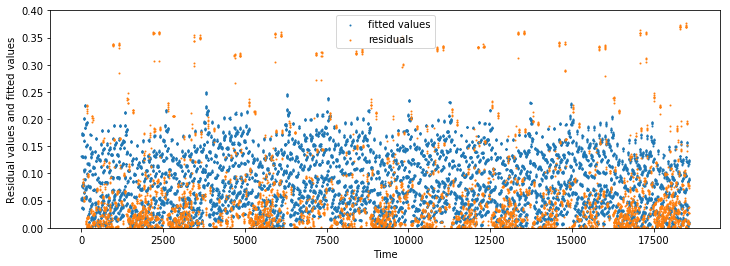

hidden_units:30
Test RMSE with cross validation: 0.0895782
Train RMSE with cross validation: 0.0883659

Fitted values vs. true values 


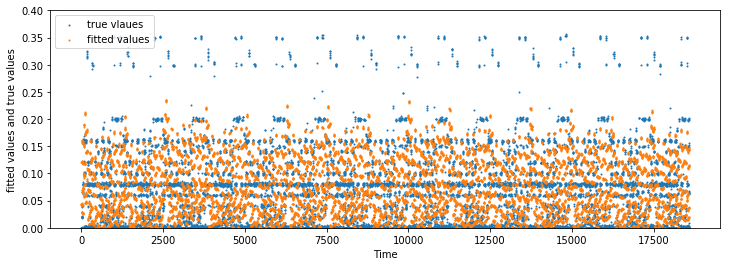

 residuals vs. ﬁtted values 


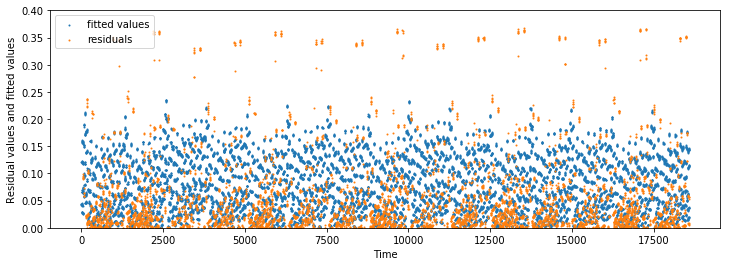

hidden_units:35
Test RMSE with cross validation: 0.0912045
Train RMSE with cross validation: 0.0887311

Fitted values vs. true values 


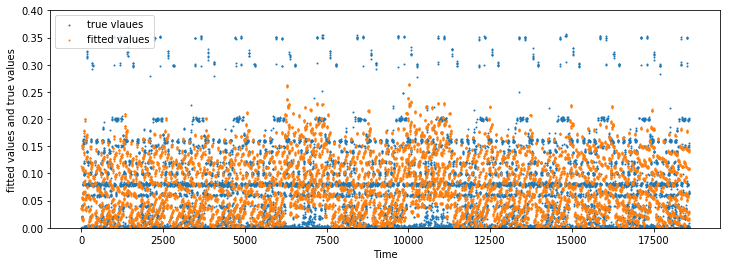

 residuals vs. ﬁtted values 


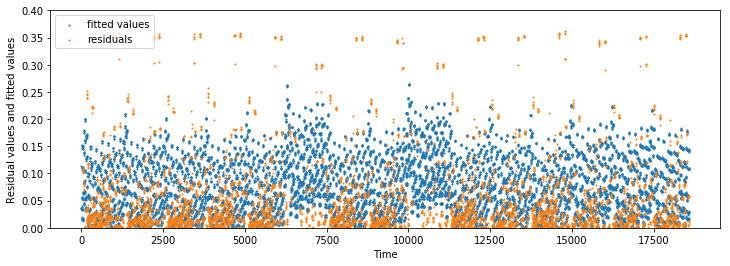

hidden_units:40
Test RMSE with cross validation: 0.0929674
Train RMSE with cross validation: 0.0883778

Fitted values vs. true values 


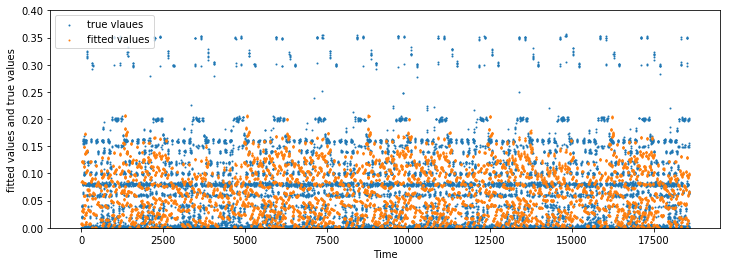

 residuals vs. ﬁtted values 


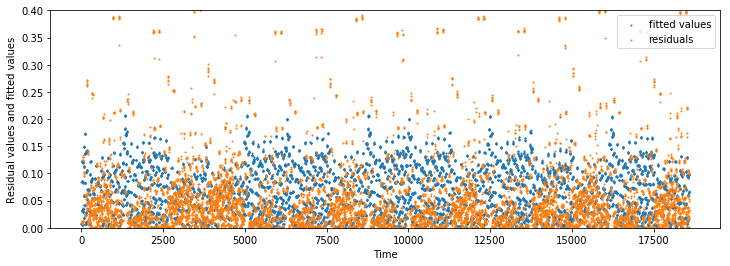

hidden_units:45
Test RMSE with cross validation: 0.0898509
Train RMSE with cross validation: 0.0888340

Fitted values vs. true values 


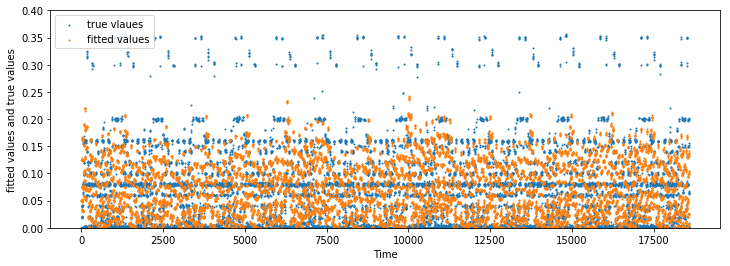

 residuals vs. ﬁtted values 


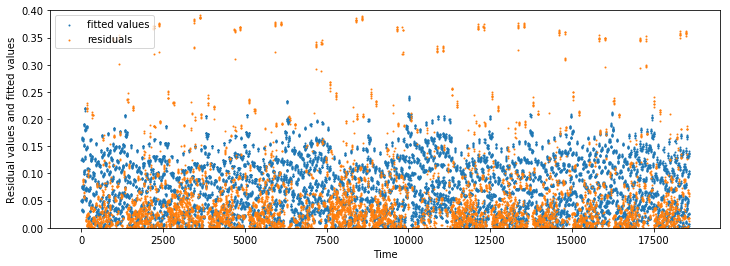

hidden_units:50
Test RMSE with cross validation: 0.0896751
Train RMSE with cross validation: 0.0883616

Fitted values vs. true values 


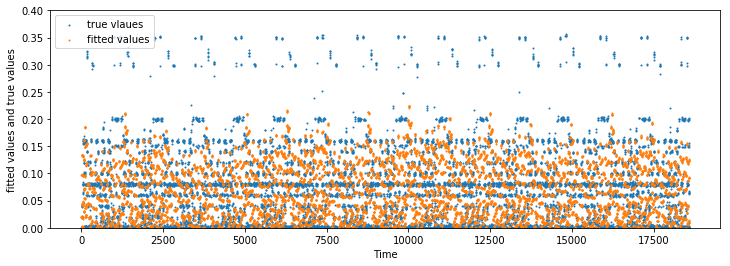

 residuals vs. ﬁtted values 


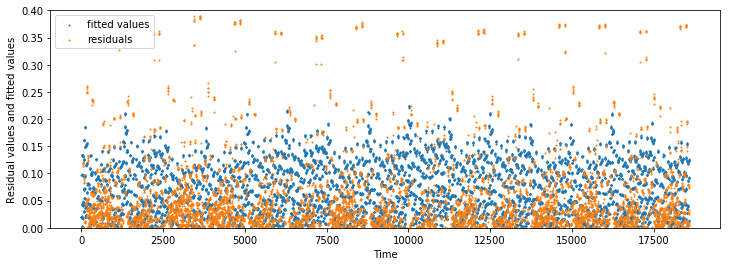

hidden_units:55
Test RMSE with cross validation: 0.0913186
Train RMSE with cross validation: 0.0883993

Fitted values vs. true values 


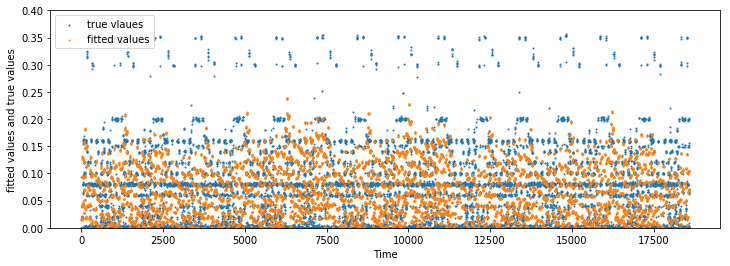

 residuals vs. ﬁtted values 


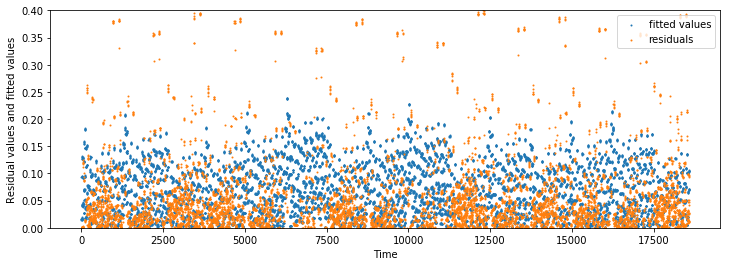

hidden_units:60
Test RMSE with cross validation: 0.0959357
Train RMSE with cross validation: 0.0883806

Fitted values vs. true values 


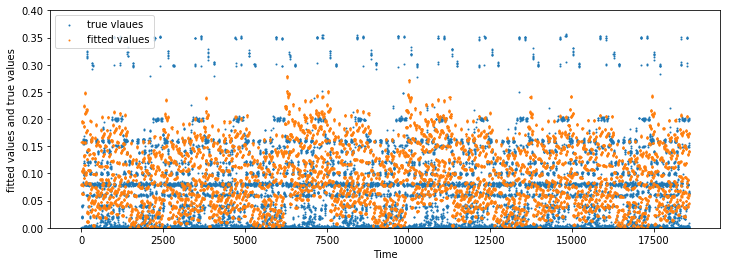

 residuals vs. ﬁtted values 


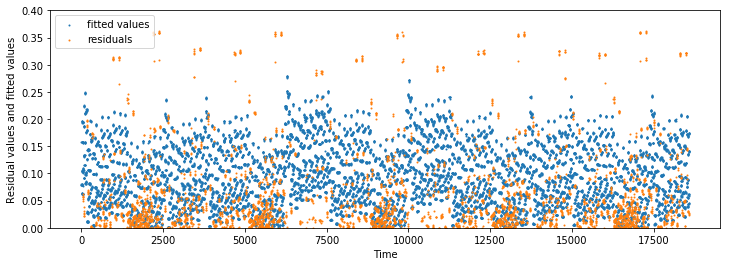

hidden_units:65
Test RMSE with cross validation: 0.0899202
Train RMSE with cross validation: 0.0884044

Fitted values vs. true values 


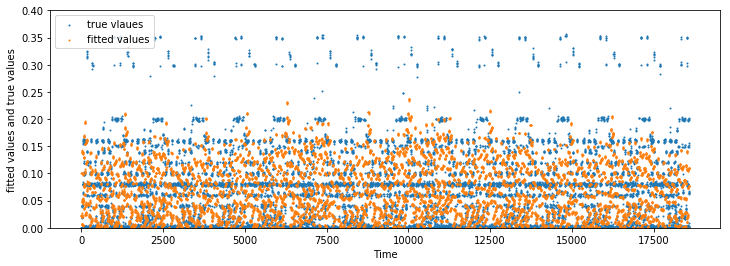

 residuals vs. ﬁtted values 


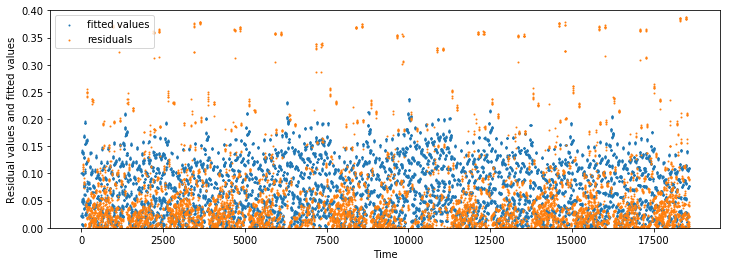

hidden_units:70
Test RMSE with cross validation: 0.0903360
Train RMSE with cross validation: 0.0884334

Fitted values vs. true values 


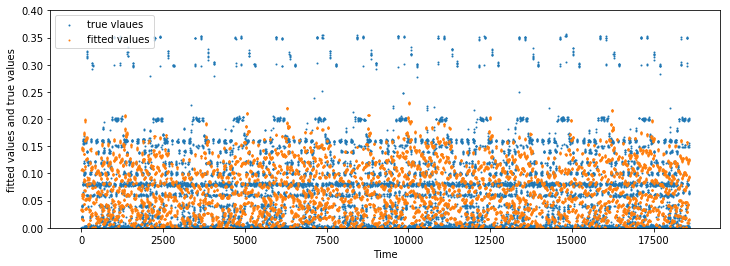

 residuals vs. ﬁtted values 


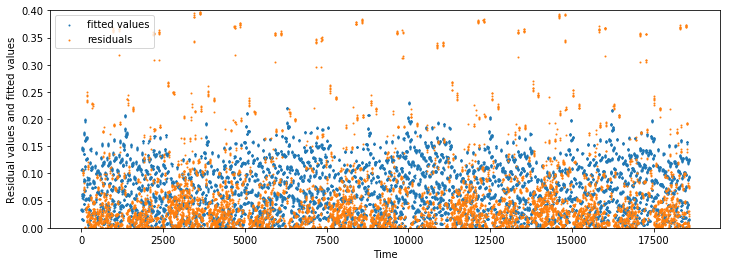

hidden_units:75
Test RMSE with cross validation: 0.0901195
Train RMSE with cross validation: 0.0885306

Fitted values vs. true values 


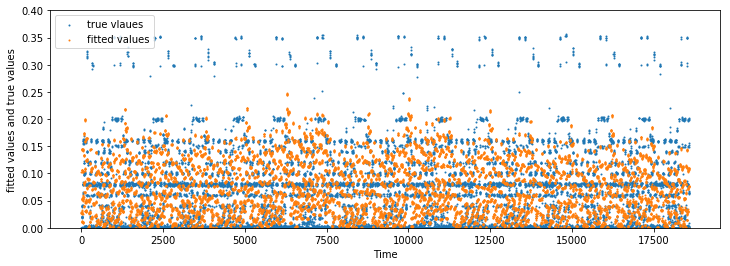

 residuals vs. ﬁtted values 


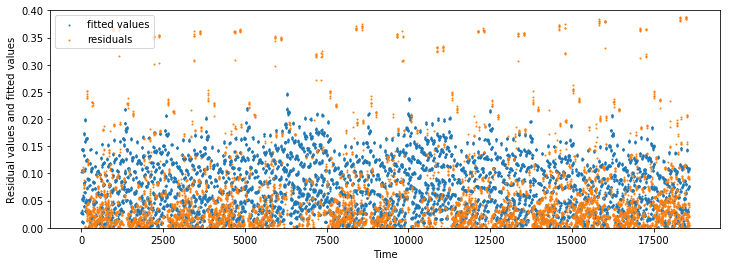

hidden_units:80
Test RMSE with cross validation: 0.0919975
Train RMSE with cross validation: 0.0884494

Fitted values vs. true values 


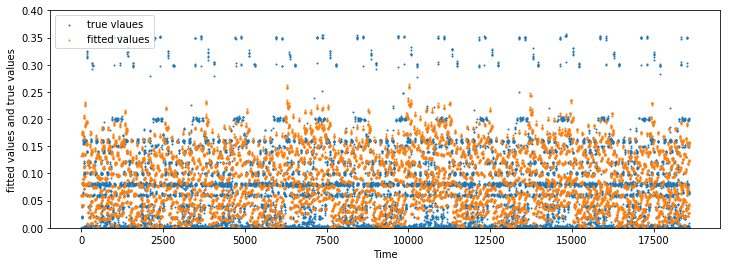

 residuals vs. ﬁtted values 


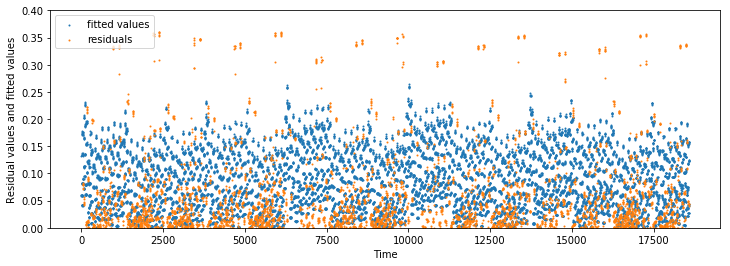

hidden_units:85
Test RMSE with cross validation: 0.0904659
Train RMSE with cross validation: 0.0884202

Fitted values vs. true values 


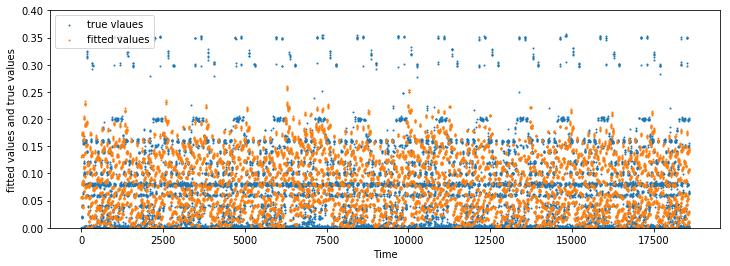

 residuals vs. ﬁtted values 


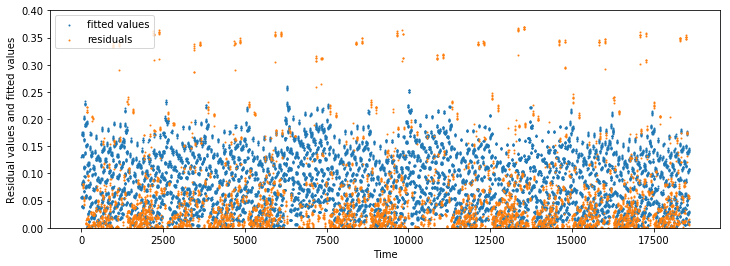

hidden_units:90
Test RMSE with cross validation: 0.0912152
Train RMSE with cross validation: 0.0886960

Fitted values vs. true values 


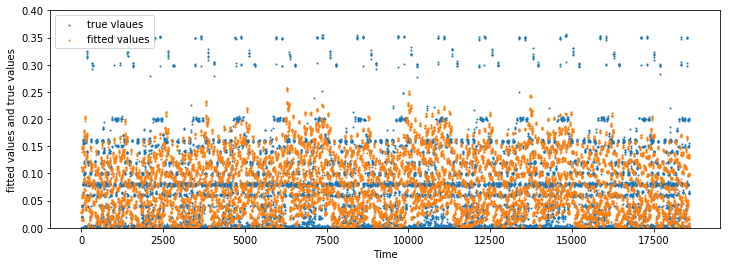

 residuals vs. ﬁtted values 


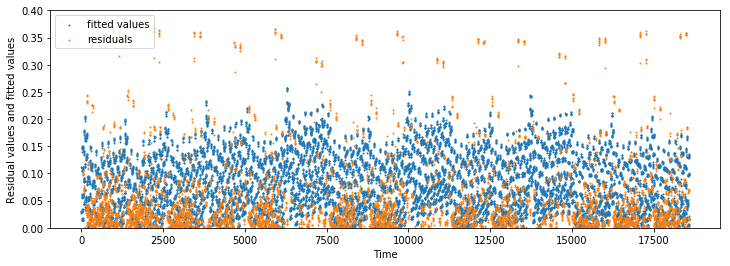

hidden_units:95
Test RMSE with cross validation: 0.0910180
Train RMSE with cross validation: 0.0886494

Fitted values vs. true values 


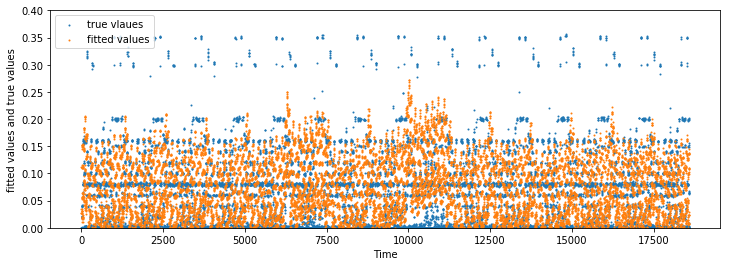

 residuals vs. ﬁtted values 


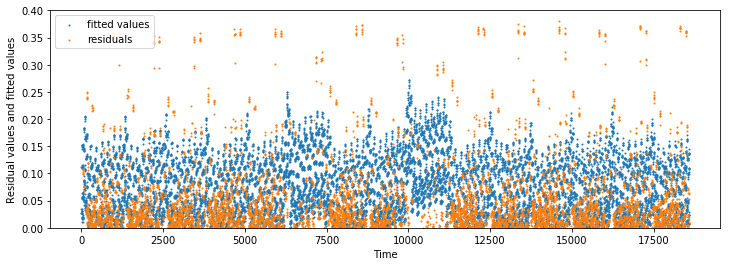

hidden_units:100
Test RMSE with cross validation: 0.0910624
Train RMSE with cross validation: 0.0883692

Fitted values vs. true values 


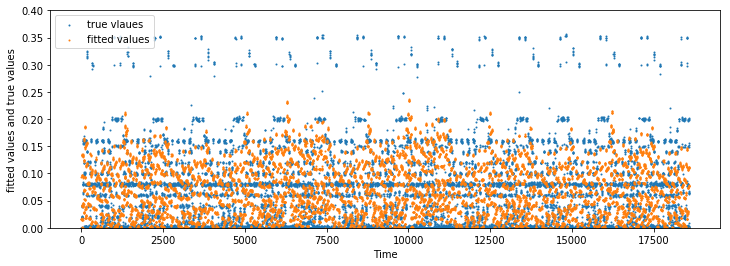

 residuals vs. ﬁtted values 


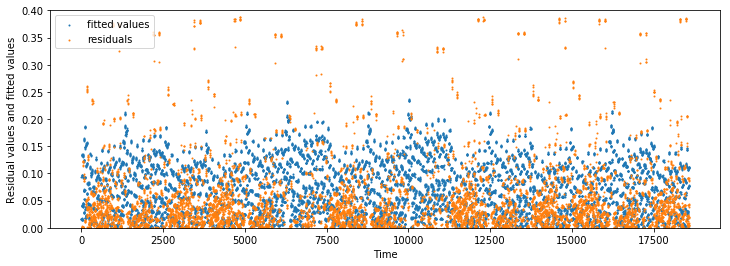

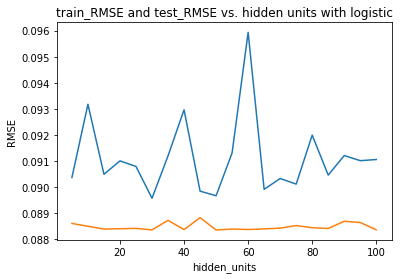

In [7]:
test_RMSE = []
train_RMSE = []

for hidden_units in range(5,105,5):
    print('hidden_units:%d'%hidden_units)
    clf_relu = MLPRegressor(activation='logistic', alpha=1e-5,hidden_layer_sizes=(hidden_units,), random_state=1)
    print_RMSEs_plot(X_enc,y,clf_relu,test_RMSE,train_RMSE)

plt.plot(range(5,105,5),test_RMSE,range(5,105,5),train_RMSE)
plt.xlabel('hidden_units')
plt.ylabel('RMSE')
plt.title('train_RMSE and test_RMSE vs. hidden units with logistic')
plt.show()

hidden_units:5
Test RMSE with cross validation: 0.1004719
Train RMSE with cross validation: 0.0877765

Fitted values vs. true values 


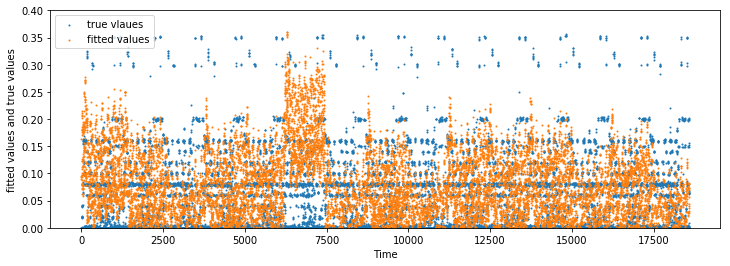

 residuals vs. ﬁtted values 


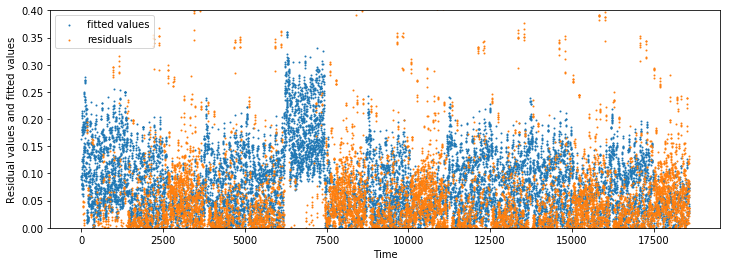

hidden_units:10
Test RMSE with cross validation: 0.1292131
Train RMSE with cross validation: 0.0885524

Fitted values vs. true values 


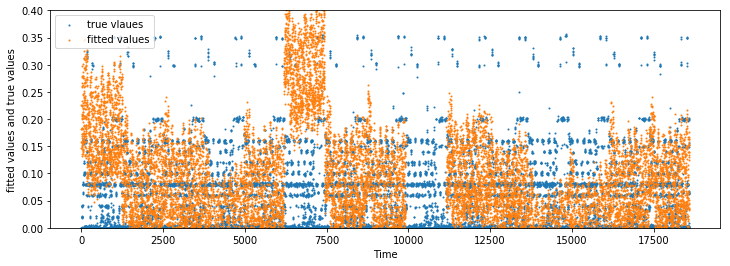

 residuals vs. ﬁtted values 


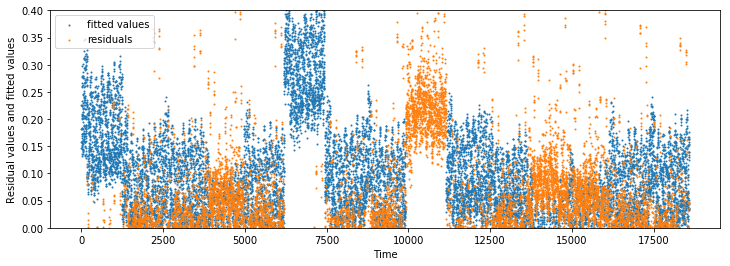

hidden_units:15
Test RMSE with cross validation: 0.1593951
Train RMSE with cross validation: 0.0885327

Fitted values vs. true values 


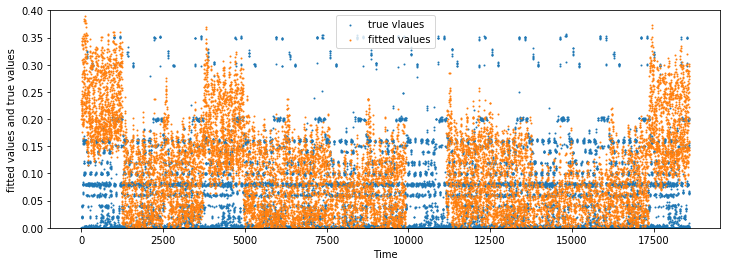

 residuals vs. ﬁtted values 


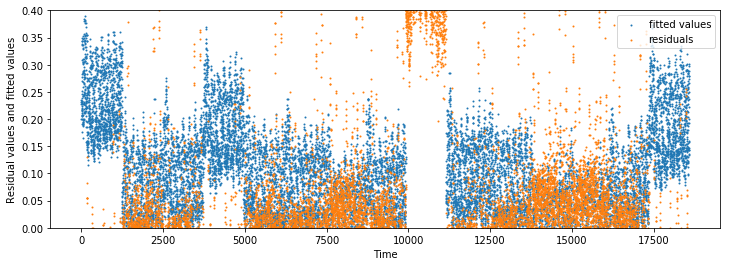

hidden_units:20
Test RMSE with cross validation: 0.1080388
Train RMSE with cross validation: 0.0819903

Fitted values vs. true values 


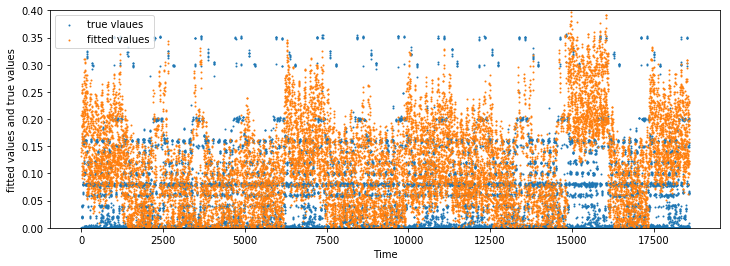

 residuals vs. ﬁtted values 


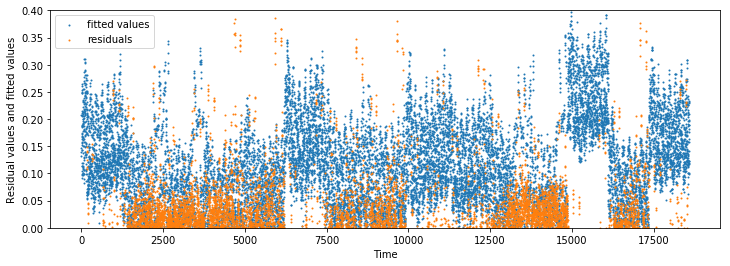

hidden_units:25
Test RMSE with cross validation: 0.1009656
Train RMSE with cross validation: 0.0530941

Fitted values vs. true values 


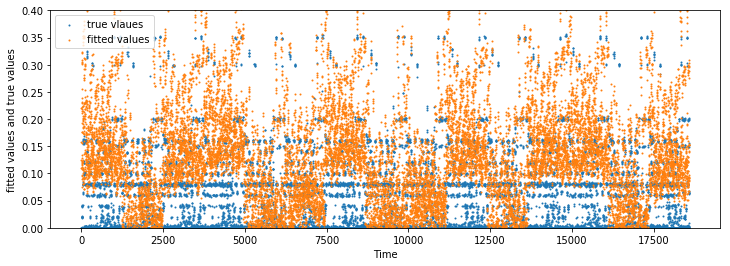

 residuals vs. ﬁtted values 


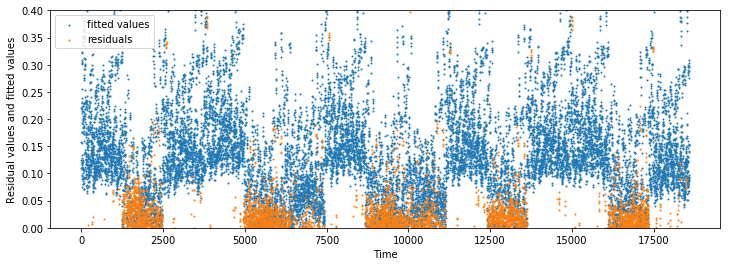

hidden_units:30
Test RMSE with cross validation: 0.1062715
Train RMSE with cross validation: 0.0895107

Fitted values vs. true values 


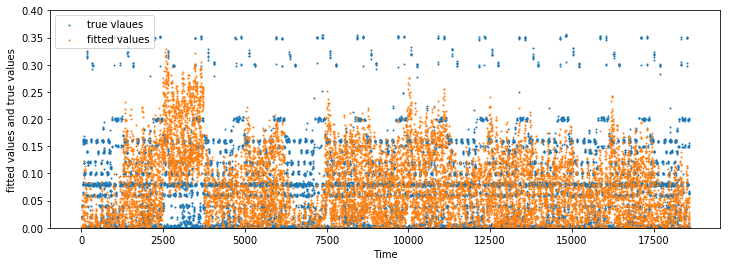

 residuals vs. ﬁtted values 


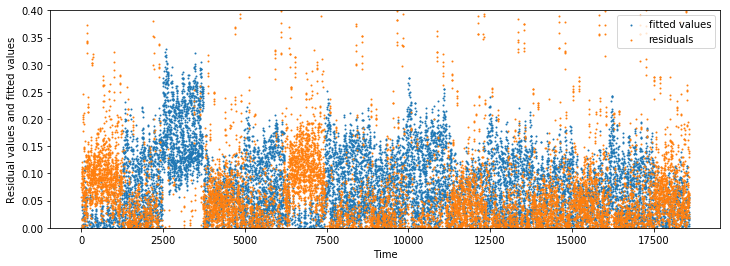

hidden_units:35
Test RMSE with cross validation: 0.0957010
Train RMSE with cross validation: 0.0637125

Fitted values vs. true values 


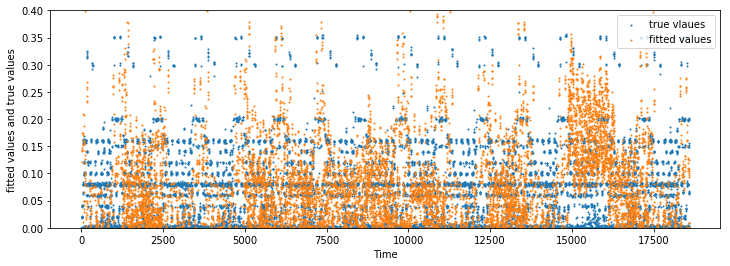

 residuals vs. ﬁtted values 


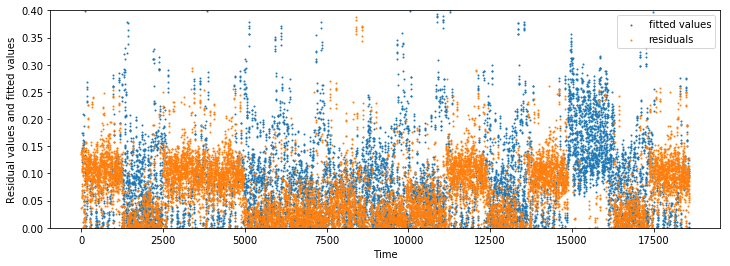

hidden_units:40
Test RMSE with cross validation: 0.0595961
Train RMSE with cross validation: 0.0571006

Fitted values vs. true values 


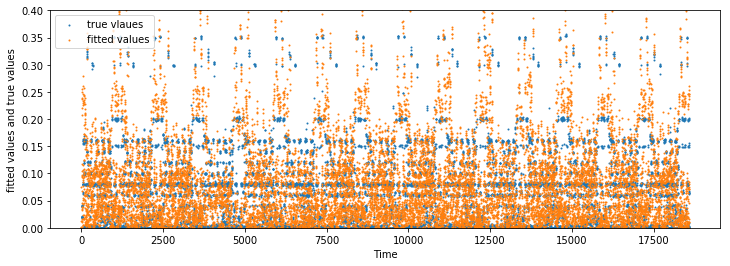

 residuals vs. ﬁtted values 


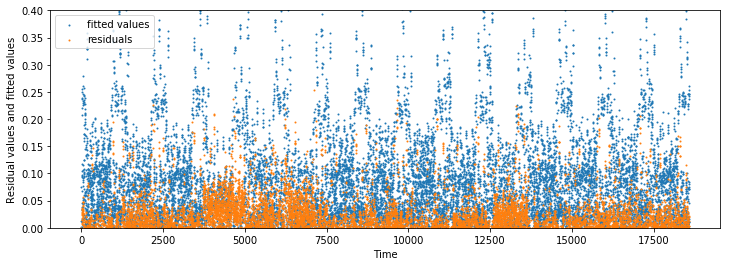

hidden_units:45
Test RMSE with cross validation: 0.0562576
Train RMSE with cross validation: 0.0526471

Fitted values vs. true values 


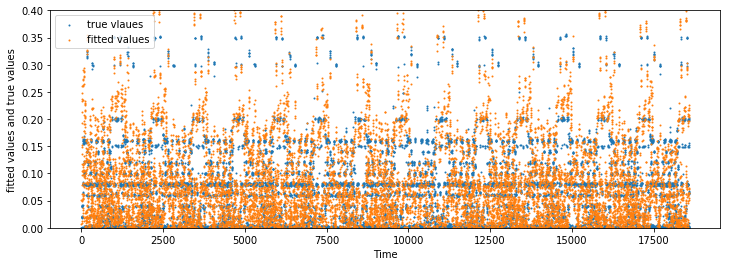

 residuals vs. ﬁtted values 


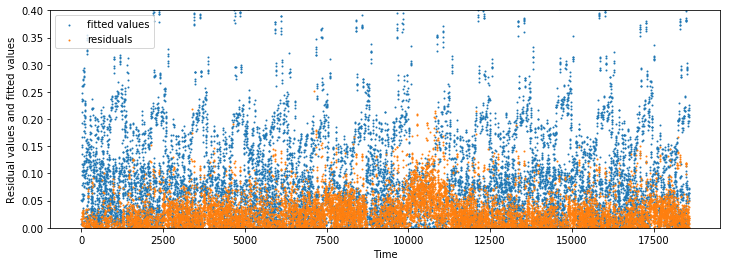

hidden_units:50
Test RMSE with cross validation: 0.1078330
Train RMSE with cross validation: 0.0886705

Fitted values vs. true values 


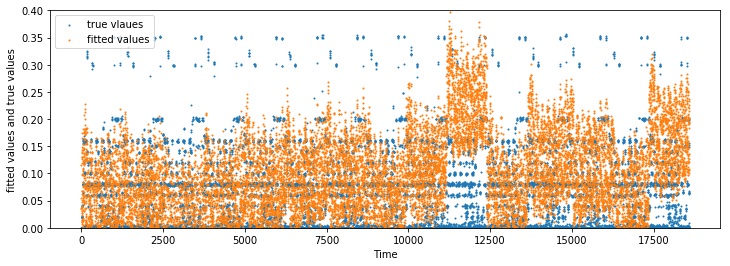

 residuals vs. ﬁtted values 


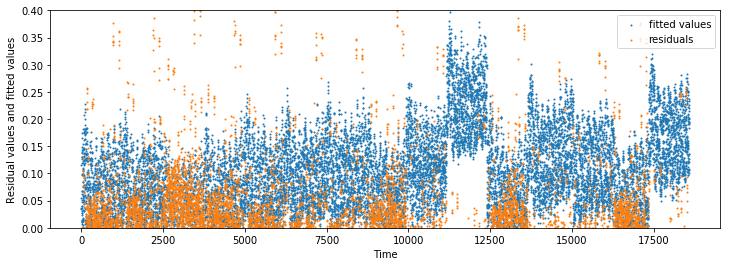

hidden_units:55
Test RMSE with cross validation: 0.0571316
Train RMSE with cross validation: 0.0548299

Fitted values vs. true values 


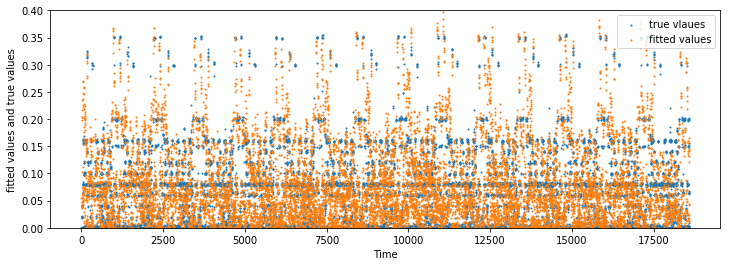

 residuals vs. ﬁtted values 


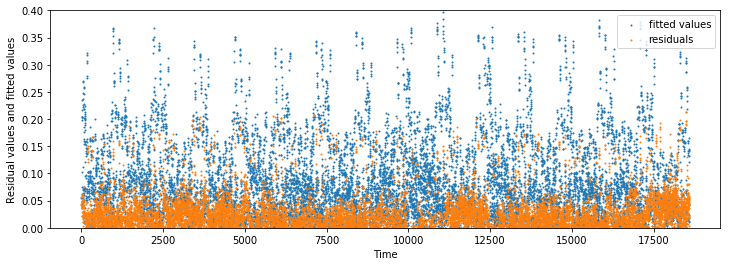

hidden_units:60
Test RMSE with cross validation: 0.1181330
Train RMSE with cross validation: 0.0894400

Fitted values vs. true values 


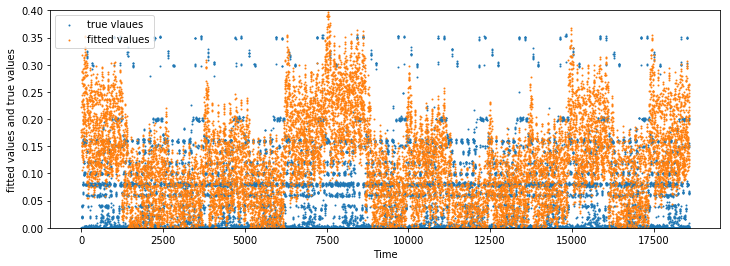

 residuals vs. ﬁtted values 


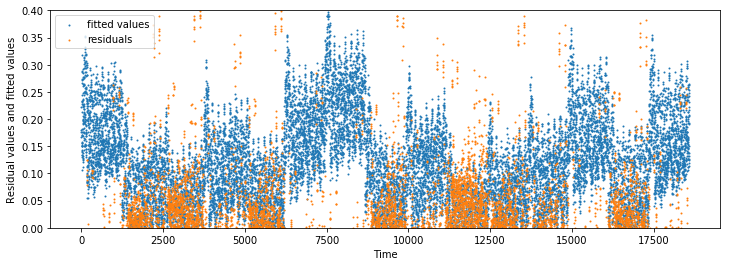

hidden_units:65
Test RMSE with cross validation: 0.1059473
Train RMSE with cross validation: 0.0887478

Fitted values vs. true values 


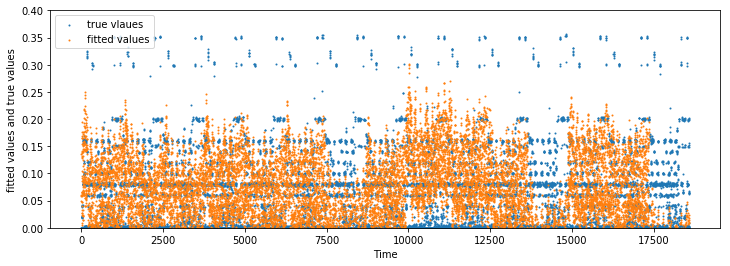

 residuals vs. ﬁtted values 


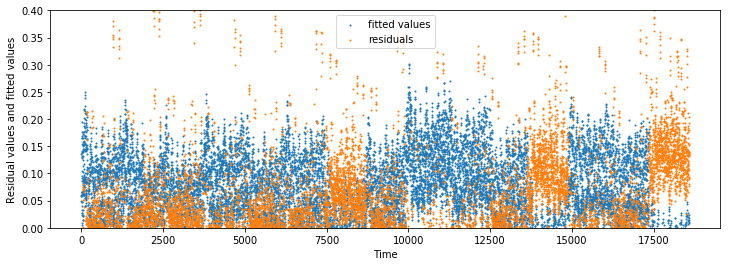

hidden_units:70
Test RMSE with cross validation: 0.1135872
Train RMSE with cross validation: 0.0758378

Fitted values vs. true values 


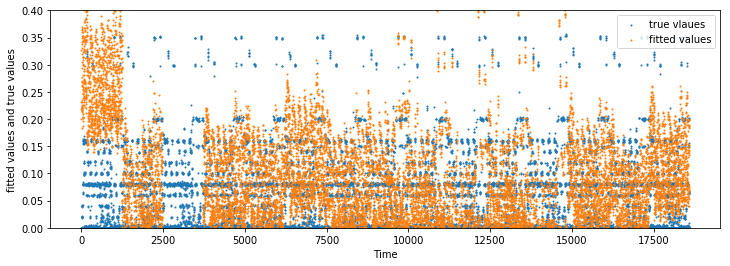

 residuals vs. ﬁtted values 


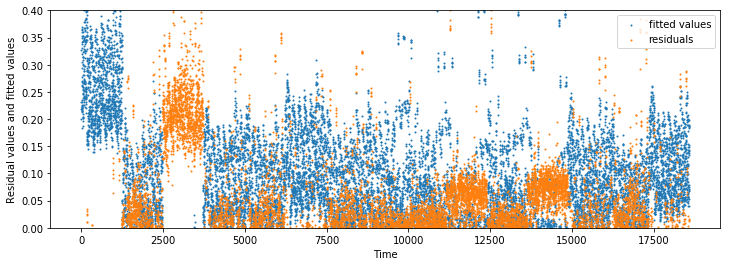

hidden_units:75
Test RMSE with cross validation: 0.1072888
Train RMSE with cross validation: 0.0889648

Fitted values vs. true values 


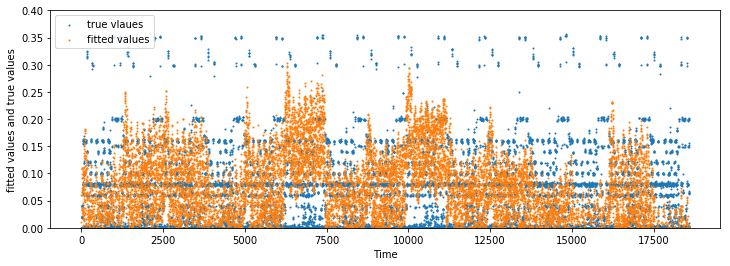

 residuals vs. ﬁtted values 


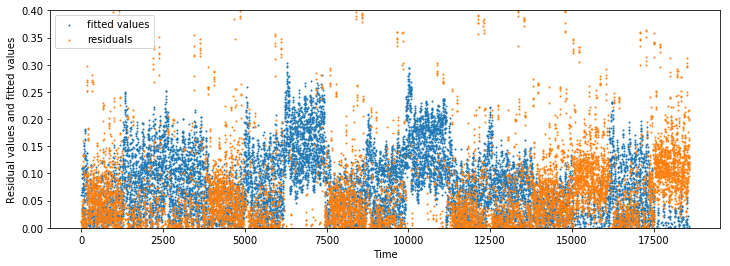

hidden_units:80
Test RMSE with cross validation: 0.0631170
Train RMSE with cross validation: 0.0601865

Fitted values vs. true values 


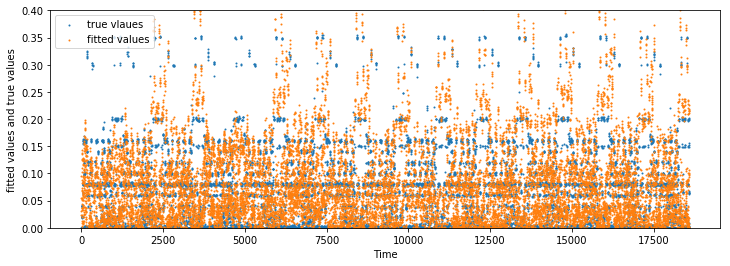

 residuals vs. ﬁtted values 


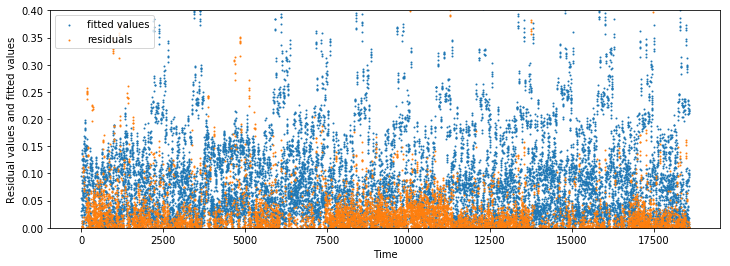

hidden_units:85
Test RMSE with cross validation: 0.0920817
Train RMSE with cross validation: 0.0761157

Fitted values vs. true values 


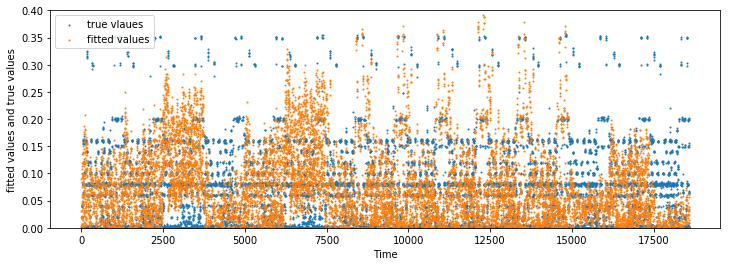

 residuals vs. ﬁtted values 


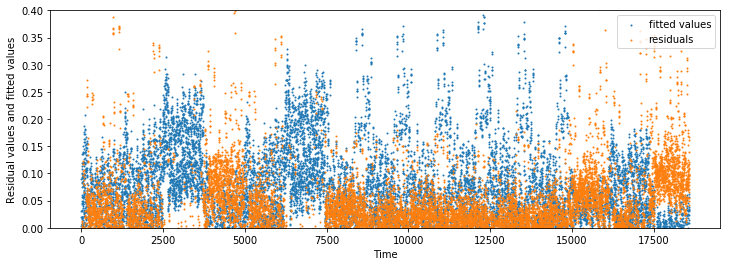

hidden_units:90
Test RMSE with cross validation: 0.0912004
Train RMSE with cross validation: 0.0730500

Fitted values vs. true values 


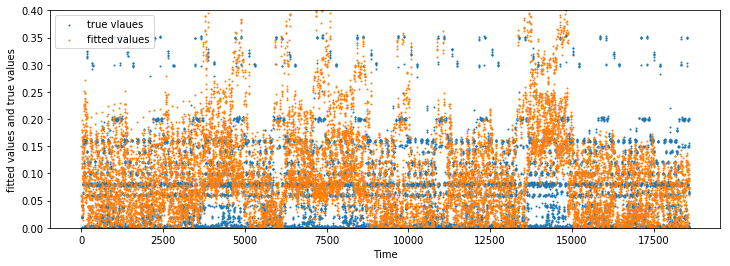

 residuals vs. ﬁtted values 


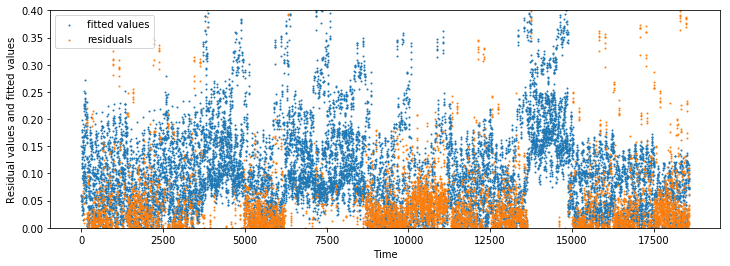

hidden_units:95
Test RMSE with cross validation: 0.1225303
Train RMSE with cross validation: 0.0880251

Fitted values vs. true values 


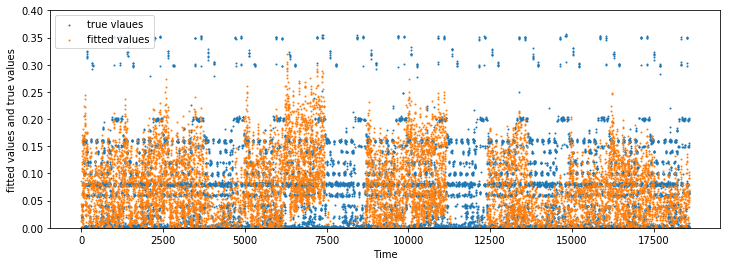

 residuals vs. ﬁtted values 


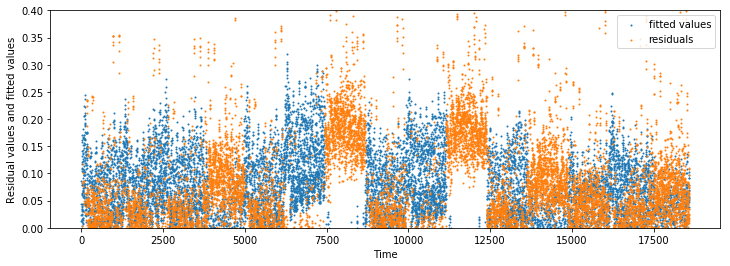

hidden_units:100
Test RMSE with cross validation: 0.0550122
Train RMSE with cross validation: 0.0518073

Fitted values vs. true values 


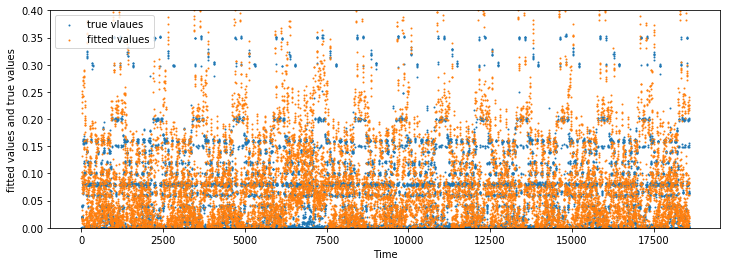

 residuals vs. ﬁtted values 


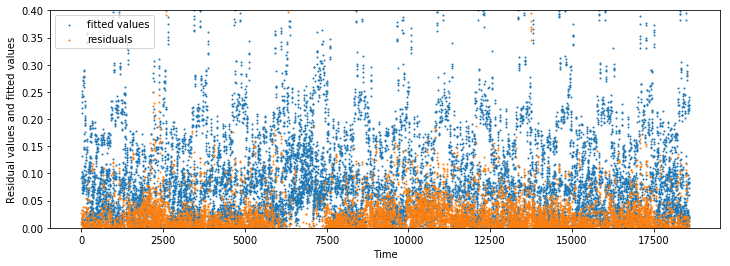

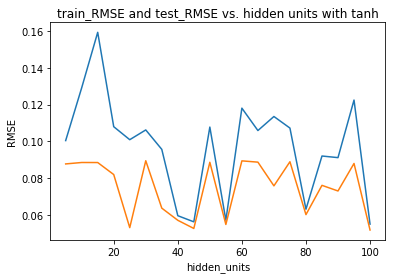

In [8]:
test_RMSE = []
train_RMSE = []

for hidden_units in range(5,105,5):
    print('hidden_units:%d'%hidden_units)
    clf_relu = MLPRegressor(activation='tanh', alpha=1e-5,hidden_layer_sizes=(hidden_units,), random_state=1)
    print_RMSEs_plot(X_enc,y,clf_relu,test_RMSE,train_RMSE)

plt.plot(range(5,105,5),test_RMSE,range(5,105,5),train_RMSE)
plt.xlabel('hidden_units')
plt.ylabel('RMSE')
plt.title('train_RMSE and test_RMSE vs. hidden units with tanh')
plt.show()

# Part e k-nearest neighbor regression

k = 1
Test RMSE with cross validation: 0.0201658
Train RMSE with cross validation: 0.0000000

Fitted values vs. true values 


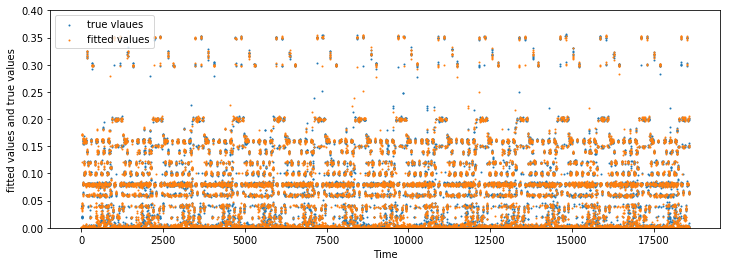

 residuals vs. ﬁtted values 


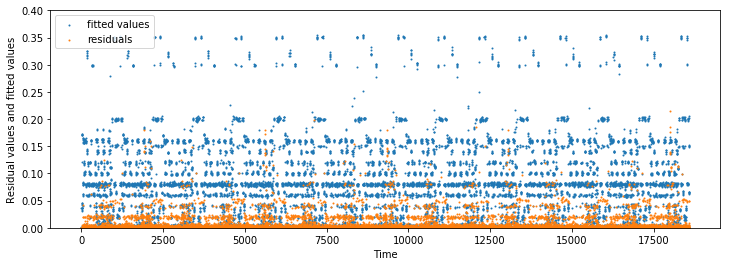

k = 2
Test RMSE with cross validation: 0.0343122
Train RMSE with cross validation: 0.0289562

Fitted values vs. true values 


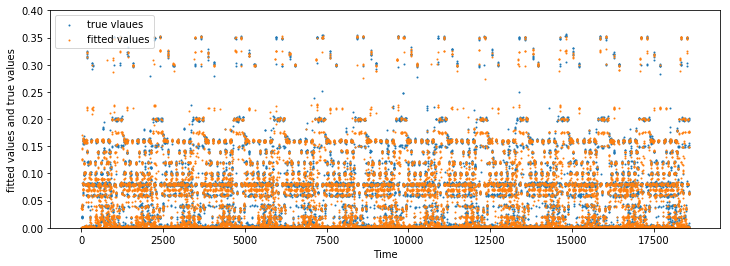

 residuals vs. ﬁtted values 


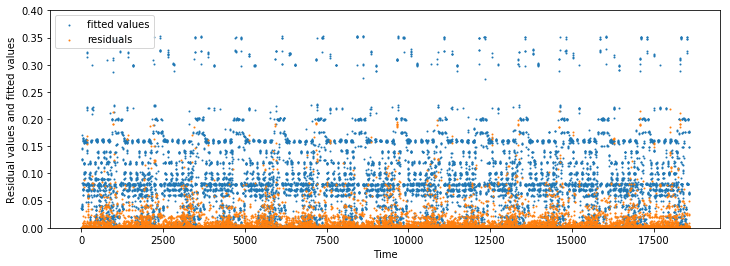

k = 3
Test RMSE with cross validation: 0.0363105
Train RMSE with cross validation: 0.0299732

Fitted values vs. true values 


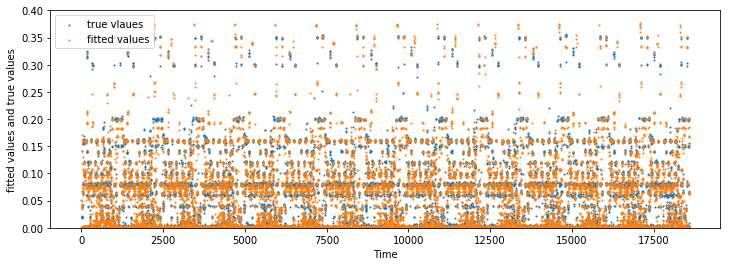

 residuals vs. ﬁtted values 


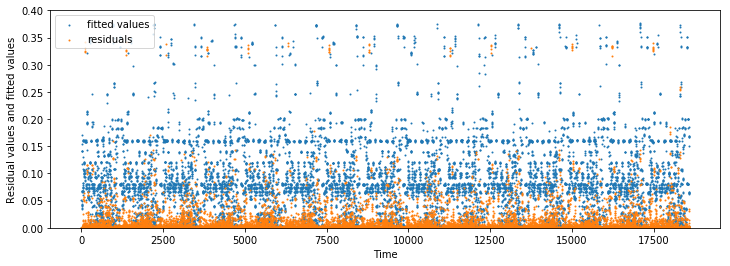

k = 4
Test RMSE with cross validation: 0.0374536
Train RMSE with cross validation: 0.0284126

Fitted values vs. true values 


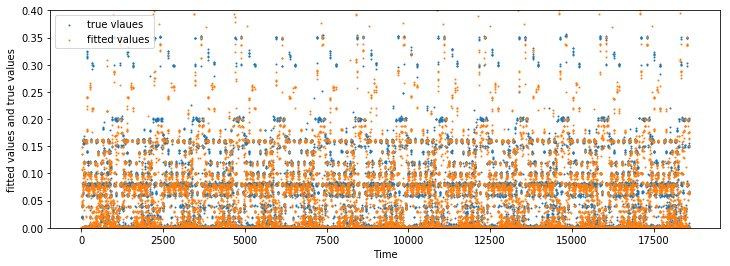

 residuals vs. ﬁtted values 


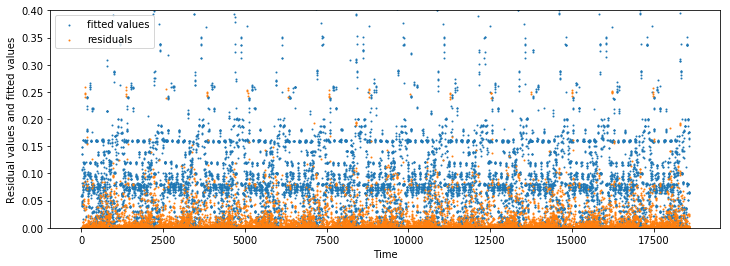

k = 5
Test RMSE with cross validation: 0.0433936
Train RMSE with cross validation: 0.0269626

Fitted values vs. true values 


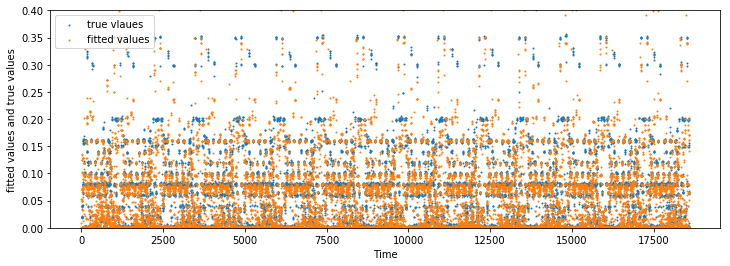

 residuals vs. ﬁtted values 


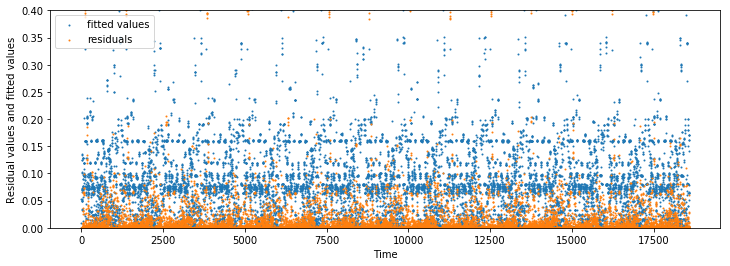

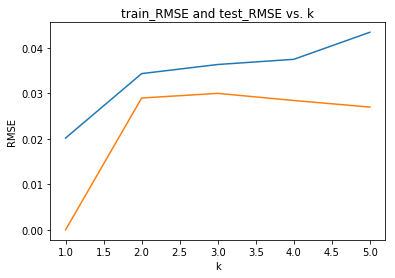

In [9]:
from sklearn.neighbors import KNeighborsRegressor

test_RMSE = []
train_RMSE = []

for k in range(1,6):
    print('k = %d'%k)
    knn = KNeighborsRegressor(n_neighbors=k)
    print_RMSEs_plot(X,y,knn,test_RMSE,train_RMSE)
    
plt.plot(range(1,6),test_RMSE,range(1,6),train_RMSE)
plt.xlabel('k')
plt.ylabel('RMSE')
plt.title('train_RMSE and test_RMSE vs. k')
plt.show()